# Import dependencies

In [1]:
import numpy as np
import pandas as pd
import pyarrow.parquet as pq
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

# Initialize labels and matplot

,path,file_id,sequence_id,participant_id,phrase
0,train_landmarks/5414471.parquet,5414471,1816796431,217,3 creekhouse
1,train_landmarks/5414471.parquet,5414471,1816825349,107,scales/kuhaylah
2,train_landmarks/5414471.parquet,5414471,1816909464,1,1383 william lanier
3,train_landmarks/5414471.parquet,5414471,1816967051,63,988 franklin lane
4,train_landmarks/5414471.parquet,5414471,1817123330,89,6920 northeast 661st road


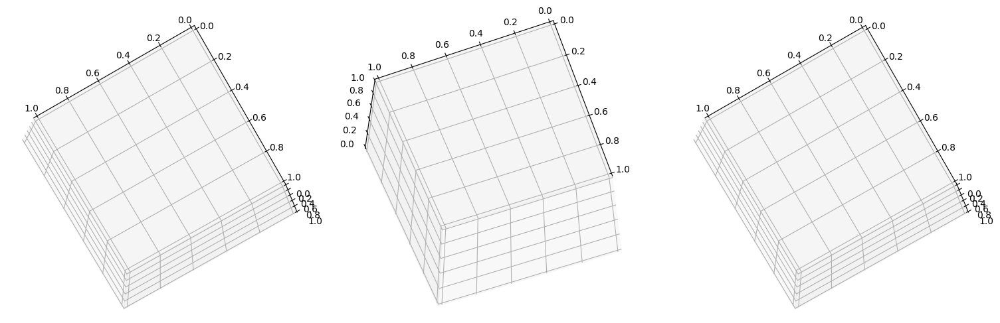

In [2]:
INPUT_DIR = "/kaggle/input/asl-fingerspelling/"

LIP_LIST = [0,17,37,39,40,57,84,91,181,267,269,270,287,314,321,405]

RHAND_LBLS = [f'x_right_hand_{i}' for i in range(21)] + [f'y_right_hand_{i}' for i in range(21)] + [f'z_right_hand_{i}' for i in range(21)]
LHAND_LBLS = [f'x_left_hand_{i}' for i in range(21)] + [f'y_left_hand_{i}' for i in range(21)] + [f'z_left_hand_{i}' for i in range(21)]

LIP_LBLS_X   = [f'x_face_{i}' for i in LIP_LIST] 
LIP_LBLS_Y   = [f'y_face_{i}' for i in LIP_LIST] 
LIP_LBLS_Z   = [f'z_face_{i}' for i in LIP_LIST] 

LIP_LBLS     = LIP_LBLS_X + LIP_LBLS_Y + LIP_LBLS_Z

fig = plt.figure(figsize=(15, 5))
rh_ax = fig.add_subplot(131, projection="3d")
rh_ax.view_init(100, 60)

lh_ax = fig.add_subplot(133, projection="3d")
lh_ax.view_init(100, 60)

lip_ax = fig.add_subplot(132, projection="3d")
lip_ax.view_init(300, 200)

fig.tight_layout()
fig.subplots_adjust(left=0, right=1, bottom=0, top=0.9)

LINE_WIDTH = 5

train_df = pd.read_csv(f'{INPUT_DIR}/train.csv')
train_df.head()

# Functions

In [3]:

def hand_lines(hands_landmarks):
    
    landmark_point = hands_landmarks

    palm_list = [0, 1, 5, 9, 13, 17, 0]
    thumb_list = [1, 2, 3, 4]
    index_finger_list = [5, 6, 7, 8]
    middle_finger_list = [9, 10, 11, 12]
    ring_finger_list = [13, 14, 15, 16]
    pinky_list = [17, 18, 19, 20]

    palm_x, palm_y, palm_z = [], [], []
    for index in palm_list:
        point = landmark_point[index]
        palm_x.append(point[0])
        palm_y.append(point[1])
        palm_z.append(point[2])

    thumb_x, thumb_y, thumb_z = [], [], []
    for index in thumb_list:
        point = landmark_point[index]
        thumb_x.append(point[0])
        thumb_y.append(point[1])
        thumb_z.append(point[2])

    index_finger_x, index_finger_y, index_finger_z = [], [], []
    for index in index_finger_list:
        point = landmark_point[index]
        index_finger_x.append(point[0])
        index_finger_y.append(point[1])
        index_finger_z.append(point[2])

    middle_finger_x, middle_finger_y, middle_finger_z = [], [], []
    for index in middle_finger_list:
        point = landmark_point[index]
        middle_finger_x.append(point[0])
        middle_finger_y.append(point[1])
        middle_finger_z.append(point[2])

    ring_finger_x, ring_finger_y, ring_finger_z = [], [], []
    for index in ring_finger_list:
        point = landmark_point[index]
        ring_finger_x.append(point[0])
        ring_finger_y.append(point[1])
        ring_finger_z.append(point[2])

    pinky_x, pinky_y, pinky_z = [], [], []
    for index in pinky_list:
        point = landmark_point[index]
        pinky_x.append(point[0])
        pinky_y.append(point[1])
        pinky_z.append(point[2])

    return [palm_x, palm_y, palm_z], [thumb_x, thumb_y, thumb_z], [index_finger_x, index_finger_y, index_finger_z], [middle_finger_x, middle_finger_y, middle_finger_z], [ring_finger_x, ring_finger_y, ring_finger_z], [pinky_x, pinky_y, pinky_z]

def lip_lines(lip_landmarks):
    
    landmark_point = lip_landmarks

    for idx in range(0,len(lip_landmarks)):
        landmark_point[idx][0] =  0.5 - lip_landmarks[idx][0] 
        landmark_point[idx][1] =  lip_landmarks[idx][1] 
        landmark_point[idx][2] =  0.3 - lip_landmarks[idx][2] 

    landmark_point =  {LIP_LIST: lip_landmarks for LIP_LIST, lip_landmarks in zip(LIP_LIST, lip_landmarks)}

    up_list   = [57, 40, 39, 37, 0, 267, 269, 270, 287]
    down_list = [57, 91, 181, 84, 17, 314, 405, 321, 287]


    up_lip_x, up_lip_y, up_lip_z = [], [], []
    for index in up_list:
        point = landmark_point[index]
        up_lip_x.append(point[0])
        up_lip_y.append(point[1])
        up_lip_z.append(point[2])

    down_lip_x, down_lip_y, down_lip_z = [], [], []
    for index in down_list:
        point = landmark_point[index]
        down_lip_x.append(point[0])
        down_lip_y.append(point[1])
        down_lip_z.append(point[2])    

    return [up_lip_x, up_lip_y,up_lip_z], [down_lip_x, down_lip_y, down_lip_z]

def plot_landmarks(plt, ax_list, landmarks):
    ax_list[0].cla()
    ax_list[1].cla()
    ax_list[2].cla()

    handedness_index = 0

    palm, thumb, index_finger, middle_finger, ring_finger, pinky = hand_lines(landmarks[0])
    

    ax_list[handedness_index].plot(palm[0], palm[1], palm[2], linewidth=LINE_WIDTH)
    ax_list[handedness_index].plot(thumb[0], thumb[1], thumb[2], linewidth=LINE_WIDTH*2)
    ax_list[handedness_index].plot(index_finger[0], index_finger[1], index_finger[2], linewidth=LINE_WIDTH*1.5)
    ax_list[handedness_index].plot(middle_finger[0], middle_finger[1], middle_finger[2], linewidth=LINE_WIDTH*1.4)
    ax_list[handedness_index].plot(ring_finger[0], ring_finger[1], ring_finger[2], linewidth=LINE_WIDTH*1.3)
    ax_list[handedness_index].plot(pinky[0], pinky[1], pinky[2], linewidth=LINE_WIDTH*1.2)
    ax_list[handedness_index].set_title("Right Hand")

    handedness_index = 1

    palm, thumb, index_finger, middle_finger, ring_finger, pinky = hand_lines(landmarks[1])
    

    ax_list[handedness_index].plot(palm[0], palm[1], palm[2], linewidth=LINE_WIDTH)
    ax_list[handedness_index].plot(thumb[0], thumb[1], thumb[2], linewidth=LINE_WIDTH*2)
    ax_list[handedness_index].plot(index_finger[0], index_finger[1], index_finger[2], linewidth=LINE_WIDTH*1.5)
    ax_list[handedness_index].plot(middle_finger[0], middle_finger[1], middle_finger[2], linewidth=LINE_WIDTH*1.4)
    ax_list[handedness_index].plot(ring_finger[0], ring_finger[1], ring_finger[2], linewidth=LINE_WIDTH*1.3)
    ax_list[handedness_index].plot(pinky[0], pinky[1], pinky[2], linewidth=LINE_WIDTH*1.2)
    ax_list[handedness_index].set_title("Left Hand")

    handedness_index = 2

    up_lip, down_lip = lip_lines(landmarks[2])
    
    ax_list[handedness_index].plot(up_lip[0], up_lip[1], up_lip[2], linewidth=LINE_WIDTH*2)
    ax_list[handedness_index].plot(down_lip[0], down_lip[1], down_lip[2], linewidth=LINE_WIDTH*4)
    ax_list[handedness_index].set_title("Lips")
    return

def get_random_sequence(phrase_idx=None):
    if phrase_idx == None:
        phrase_idx = np.random.randint(len(train_df))

    selected_row = train_df.iloc[phrase_idx]
    file_id = int(selected_row['file_id'])
    sequence_id = int(selected_row['sequence_id'])
    phrase = selected_row['phrase']
       
    dataset = pq.read_table(
        f'{INPUT_DIR}train_landmarks/{str(file_id)}.parquet',
        filters=[
            [('sequence_id', '=', sequence_id)],
        ],
        columns= LHAND_LBLS+RHAND_LBLS+LIP_LBLS
    )
    
    sequence_df = dataset.to_pandas()

    return phrase_idx, phrase, sequence_df

def get_sequence(sequence_id):
    selected_row = train_df[train_df.sequence_id == sequence_id]
    file_id = int(selected_row['file_id'])
    sequence_id = int(selected_row['sequence_id'])
    phrase = selected_row['phrase']
       
    dataset = pq.read_table(
        f'{INPUT_DIR}train_landmarks/{str(file_id)}.parquet',
        filters=[
            [('sequence_id', '=', sequence_id)],
        ],
        columns= LHAND_LBLS+RHAND_LBLS+LIP_LBLS
    )
    
    sequence_df = dataset.to_pandas()

    return sequence_df, phrase

def filter_df(seq_df):

    right_hand_landmarks = []
    left_hand_landmarks = []
    lip_landmarks =[]

    for seq_idx in range(len(seq_df)):
        r_x_pose = seq_df.iloc[seq_idx].filter(regex="x_right_hand.*").values
        r_y_pose = seq_df.iloc[seq_idx].filter(regex="y_right_hand.*").values
        r_z_pose = seq_df.iloc[seq_idx].filter(regex="z_right_hand.*").values

        l_x_pose = seq_df.iloc[seq_idx].filter(regex="x_left_hand.*").values
        l_y_pose = seq_df.iloc[seq_idx].filter(regex="y_left_hand.*").values
        l_z_pose = seq_df.iloc[seq_idx].filter(regex="z_left_hand.*").values

        lip_x_pose = seq_df.iloc[seq_idx].filter(LIP_LBLS_X).values
        lip_y_pose = seq_df.iloc[seq_idx].filter(LIP_LBLS_Y).values
        lip_z_pose = seq_df.iloc[seq_idx].filter(LIP_LBLS_Z).values

        right_hand_landmark = []
        left_hand_landmark = []
        lip_landmark = []

        for x, y, z in zip(r_x_pose, r_y_pose, r_z_pose):
            right_hand_landmark.append([x, y, z])
        right_hand_landmarks.append(right_hand_landmark) 

        for x, y, z in zip(l_x_pose, l_y_pose, l_z_pose):
            left_hand_landmark.append([x, y, z])
        left_hand_landmarks.append(left_hand_landmark) 

        for x, y, z in zip(lip_x_pose, lip_y_pose,lip_z_pose):
            lip_landmark.append([x, y, z])
        lip_landmarks.append(lip_landmark) 

    return  [right_hand_landmarks, left_hand_landmarks, lip_landmarks]


In [4]:
V = 2
fold = 0
model = 'base'
root = f'../working/offline/{V}/{fold}/base'
eval_df = pd.read_csv(f'{root}/eval.csv')
eval_df

,sequence_id,phrase_type,phrase_dup,phrase_true,phrase_pred,phrase_len_true,phrase_len_pred,idx,distance,score
0,1817195757,phone,0,242-197-6202,276-766-0602,12,12,0,7,0.416667
1,1817282569,phone,0,+51-2721-208-63,+51-8071-712-108063,15,19,1,8,0.466667
2,1817348598,address,1,wildberries_ru,www.baldes.com,14,14,2,11,0.214286
3,1817370426,address,1,projecteur-led,www.stansess.com/2012,14,21,3,20,0.000000
4,1817672186,phone,0,596-033-4046,5504 loop road 204,12,18,4,16,0.000000
...,...,...,...,...,...,...,...,...,...,...
95,1830116764,address,1,4308 dee guess road,3888 degus hill road,19,20,95,11,0.421053
96,1830163755,address,1,1563 big hawg,1534 bight way,13,14,96,7,0.461538
97,1830164156,address,0,126 chatnam dr,www.chmd.ru,14,11,97,11,0.214286
98,1830185459,address,1,8245 emerald meadow ct,825 west menter ct,22,18,98,11,0.500000


# Run

In [5]:
# id, phrase, df = get_random_sequence()
df, phrase = get_sequence(eval_df.loc[8, 'sequence_id'])

print(f"Phrase: {phrase}")

data_frames=filter_df(df)
tot_frames = len(data_frames[0])

print(f"Frames: {tot_frames}")

def animate(i):
    plot_landmarks(plt, [rh_ax, lh_ax, lip_ax], [data_frames[0][i],data_frames[1][i],data_frames[2][i]])     
    
plt.close()

%time myAnimation = animation.FuncAnimation(fig, animate, tot_frames, interval=500, blit=False)

myAnimation

/tmp/ipykernel_1807245/1550234120.py:150: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  file_id = int(selected_row['file_id'])
/tmp/ipykernel_1807245/1550234120.py:151: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  sequence_id = int(selected_row['sequence_id'])


Phrase: 59    6169 valley view parks
Name: phrase, dtype: object
Frames: 203
CPU times: user 96 µs, sys: 142 µs, total: 238 µs
Wall time: 279 µs


Animation size has reached 20977400 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [6]:
# id, phrase, df = get_random_sequence()
df, phrase = get_sequence(eval_df.loc[0, 'sequence_id'])

print(f"Phrase: {phrase}")

data_frames=filter_df(df)
tot_frames = len(data_frames[0])

print(f"Frames: {tot_frames}")

def animate(i):
    plot_landmarks(plt, [rh_ax, lh_ax, lip_ax], [data_frames[0][i],data_frames[1][i],data_frames[2][i]])     
    
plt.close()

%time myAnimation = animation.FuncAnimation(fig, animate, tot_frames, interval=500, blit=False)

myAnimation

/tmp/ipykernel_1807245/1550234120.py:150: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  file_id = int(selected_row['file_id'])
/tmp/ipykernel_1807245/1550234120.py:151: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  sequence_id = int(selected_row['sequence_id'])


Phrase: 8    242-197-6202
Name: phrase, dtype: object
Frames: 56
CPU times: user 169 µs, sys: 0 ns, total: 169 µs
Wall time: 211 µs
